In [46]:
# Import function to create training and test set splits
from sklearn.model_selection import train_test_split
# Import function to automatically create polynomial features! 
from sklearn.preprocessing import PolynomialFeatures
# Import Linear Regression
from sklearn.linear_model import LinearRegression
import pandas as pd
import matplotlib.pyplot as plt
# Import model_selection for cross validation
from sklearn import model_selection

from sklearn.metrics import r2_score, mean_absolute_error

import numpy as np

import warnings
warnings.filterwarnings("ignore")

### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?

In [47]:
import pandas as pd

df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


In [58]:
def non_linear_func(df):
    
    list_columns = df._get_numeric_data().columns.tolist()[:-1]
    
    for column in list_columns:
        
        X = df[[column]]

        # Test/train separación
        X_train, X_test, y_train, y_test = train_test_split(X.values, df["Price"].values, test_size=0.2)

        

        # Min and max grados a considerar
        degree_min = 2
        degree_max = 10

        scores = []
        for degree in range(degree_min,degree_max+1):
            print("-------------------------------------")
            print(column)
            polinominal_model = PolynomialFeatures(degree) 
            X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

            lin_reg_model = LinearRegression()
            lin_reg_model.fit(X_poly, y_train)
            y_pred = lin_reg_model.predict(X_poly)

            # cross validation
            name='Logistic Regression'
            kfold = model_selection.KFold(n_splits=10, random_state=42, shuffle=True) 
            
            cv_results = model_selection.cross_val_score(lin_reg_model, X_train, y_train, cv=kfold)
            msg = "%s: %f %s (%f)" % (name, cv_results.mean(), "+-", cv_results.std())

            print("Train Score:", r2_score(y_train, y_pred))
            print("Train Validation:", cv_results[degree-2])
            print("MAE:", mean_absolute_error(y_true=y_train, y_pred=y_pred))
            X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
            plt.scatter(X_train_to_show, y_train_to_show, color='g')

            X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
            plt.plot(X_train_to_show, y_pred, color='red')
            plt.title(column + " - Poninominal degree " + str(degree))
            plt.show()


-------------------------------------
Avg. Area Income
Train Score: 0.41091670404529823
Train Validation: 0.39513537345547345
MAE: 216879.79383395045


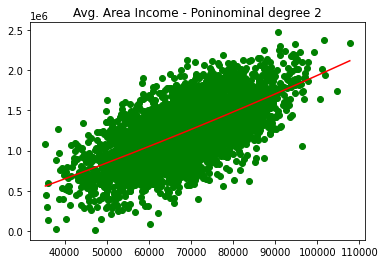

-------------------------------------
Avg. Area Income
Train Score: 0.4111060238896397
Train Validation: 0.4212751148743997
MAE: 216857.43005859928


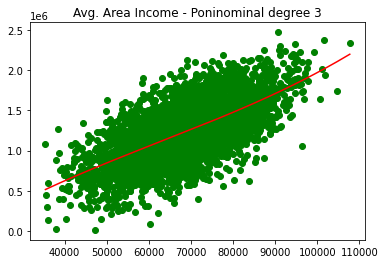

-------------------------------------
Avg. Area Income
Train Score: 0.41121099074916767
Train Validation: 0.32601706613821324
MAE: 216826.27689562208


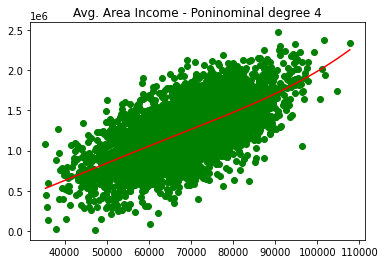

-------------------------------------
Avg. Area Income
Train Score: 0.4112453065782615
Train Validation: 0.45497066932432684
MAE: 216785.10936666827


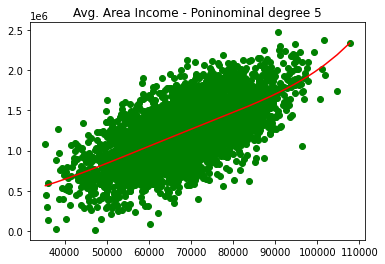

-------------------------------------
Avg. Area Income
Train Score: 0.4109227378135243
Train Validation: 0.3931848975141806
MAE: 216845.99790728372


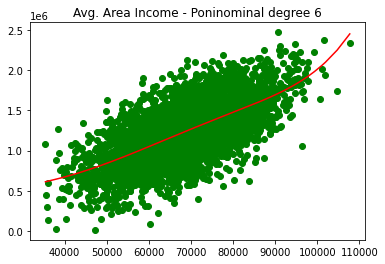

-------------------------------------
Avg. Area Income
Train Score: 0.40981920880989786
Train Validation: 0.4576331501667029
MAE: 217036.05023905862


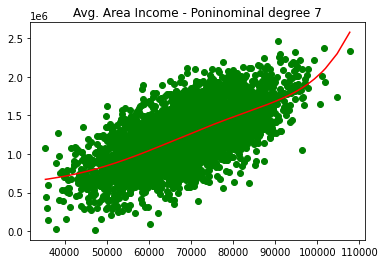

-------------------------------------
Avg. Area Income
Train Score: 0.4074966673809717
Train Validation: 0.4373706729793915
MAE: 217419.49262455304


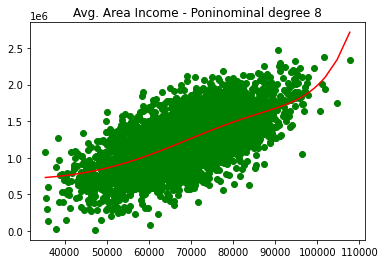

-------------------------------------
Avg. Area Income
Train Score: 0.40361818383577297
Train Validation: 0.3806632375374567
MAE: 218081.1455555947


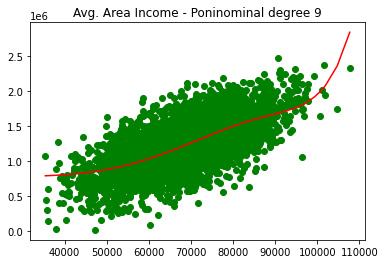

-------------------------------------
Avg. Area Income
Train Score: 0.39800079751530737
Train Validation: 0.33858496641032054
MAE: 219068.2697088189


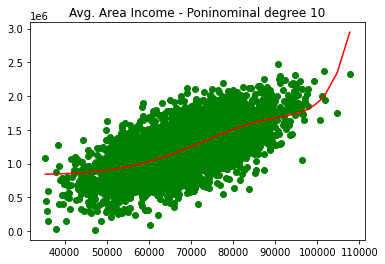

-------------------------------------
Avg. Area House Age
Train Score: 0.20183291512783597
Train Validation: 0.21536160050276543
MAE: 253193.19458701104


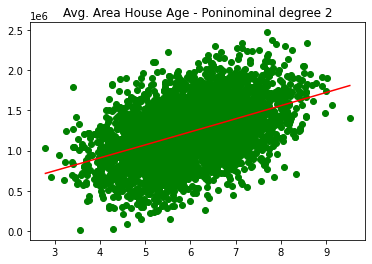

-------------------------------------
Avg. Area House Age
Train Score: 0.20242624012018107
Train Validation: 0.23895134579825206
MAE: 253177.76961815436


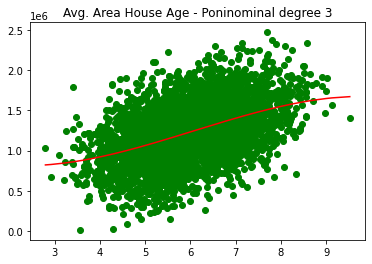

-------------------------------------
Avg. Area House Age
Train Score: 0.20290692519305553
Train Validation: 0.21193097458239685
MAE: 253072.8612838101


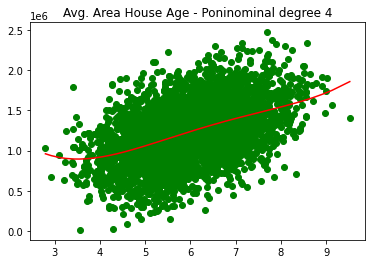

-------------------------------------
Avg. Area House Age
Train Score: 0.20290692547142097
Train Validation: 0.1911432565406247
MAE: 253072.84953870001


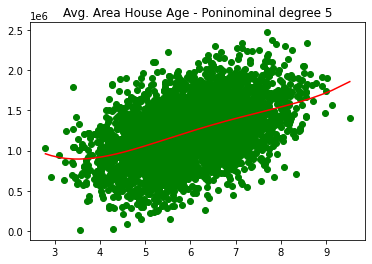

-------------------------------------
Avg. Area House Age
Train Score: 0.20336952647851492
Train Validation: 0.21788537451527845
MAE: 252975.69305937339


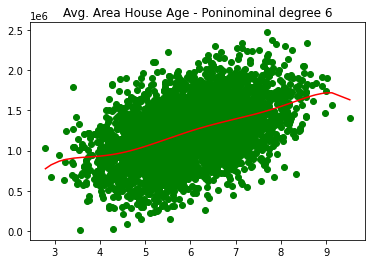

-------------------------------------
Avg. Area House Age
Train Score: 0.2045920099426467
Train Validation: 0.12271262904976254
MAE: 252533.95978979883


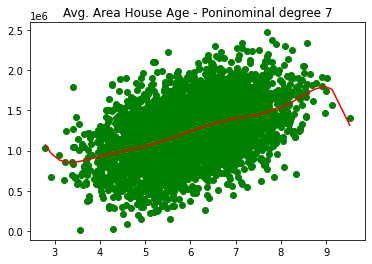

-------------------------------------
Avg. Area House Age
Train Score: 0.20459513355765957
Train Validation: 0.18415666029374334
MAE: 252525.75270624776


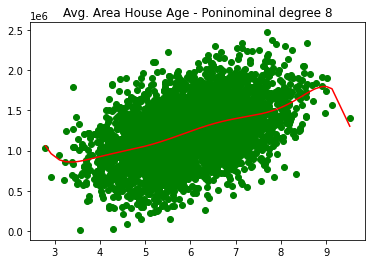

-------------------------------------
Avg. Area House Age
Train Score: 0.20524709655305873
Train Validation: 0.21787746220103443
MAE: 252354.80926622878


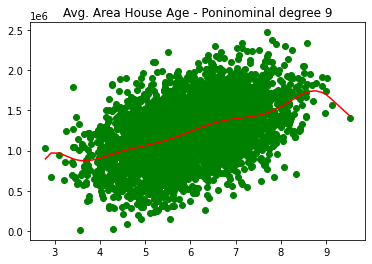

-------------------------------------
Avg. Area House Age
Train Score: 0.20541300821540864
Train Validation: 0.23941510888016526
MAE: 252418.27371699046


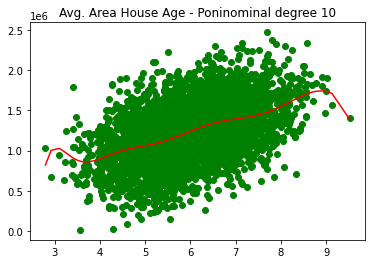

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.1196808902409312
Train Validation: 0.08051005688249557
MAE: 266154.0333406376


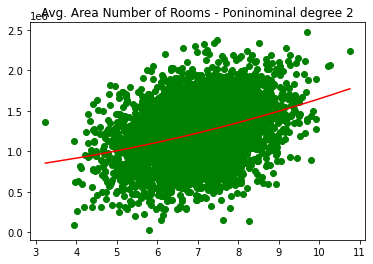

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.12032271353428736
Train Validation: 0.09555564687202933
MAE: 266129.13988457713


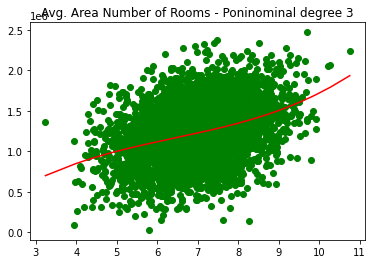

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.12060332235911375
Train Validation: 0.18344900960930988
MAE: 266076.45981911005


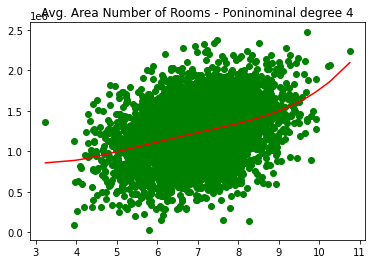

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.12063997499580681
Train Validation: 0.17380049247112106
MAE: 266091.68961829285


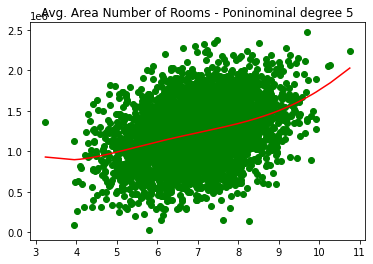

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.12096003561990765
Train Validation: 0.136592931368128
MAE: 265988.4013578732


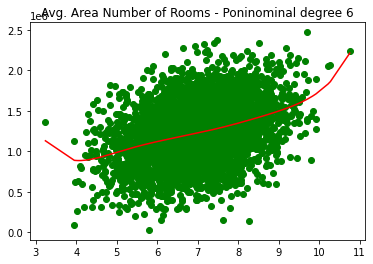

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.1209650117767439
Train Validation: 0.13762619394364906
MAE: 265982.5007301361


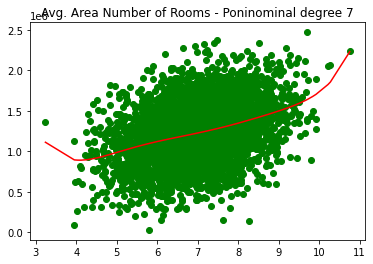

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.12163059735865389
Train Validation: 0.0877632723775883
MAE: 265936.3940821455


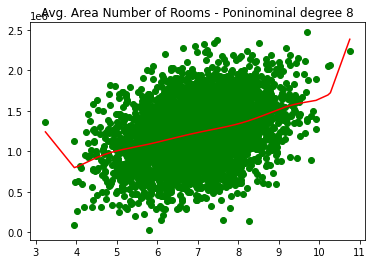

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.12278071952744374
Train Validation: 0.059002372147719084
MAE: 265668.66112960334


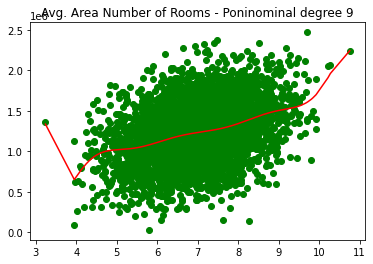

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.12287361748518344
Train Validation: 0.09774200614064332
MAE: 265676.1889023233


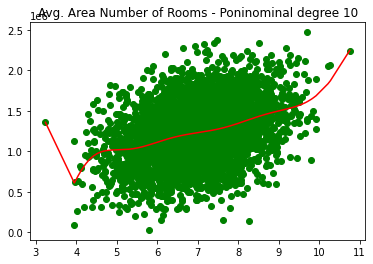

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.030290096946826717
Train Validation: 0.008927609615343224
MAE: 277313.82462689717


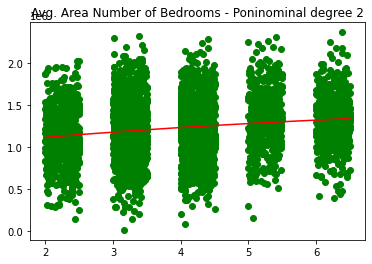

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.030338353919696526
Train Validation: 0.028165298454662313
MAE: 277277.594537055


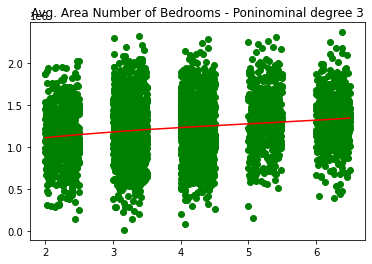

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03409897909538617
Train Validation: 0.058806730874282676
MAE: 276811.7949751053


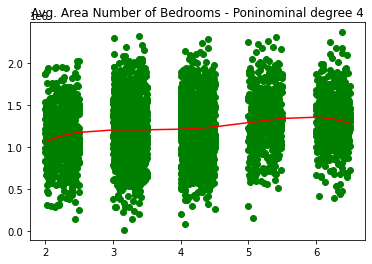

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03468482139714568
Train Validation: 0.03399004474791689
MAE: 276773.43714715086


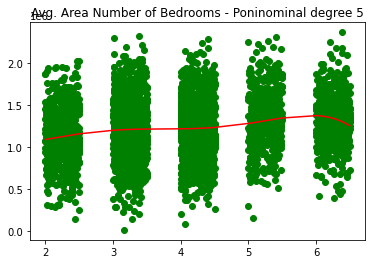

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.037170974882556274
Train Validation: 0.041687789062658465
MAE: 276366.6073859503


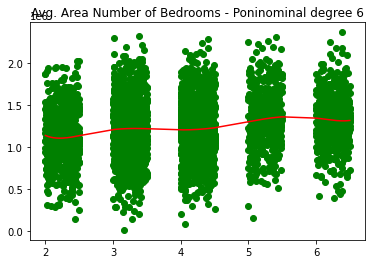

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03747471115530354
Train Validation: 0.048226775706223135
MAE: 276381.27349567186


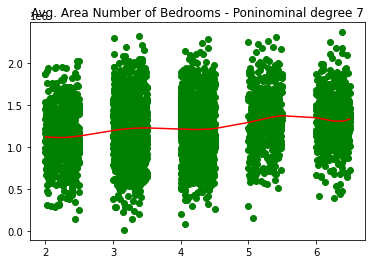

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03752203483923544
Train Validation: 0.026850773266742345
MAE: 276340.489679283


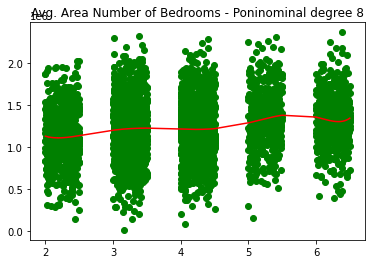

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03782495605460712
Train Validation: 0.022491222915048126
MAE: 276335.41391808615


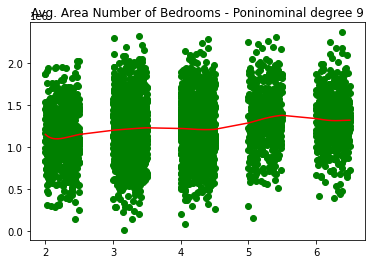

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03811832876597343
Train Validation: -0.004457823919998605
MAE: 276281.2813504673


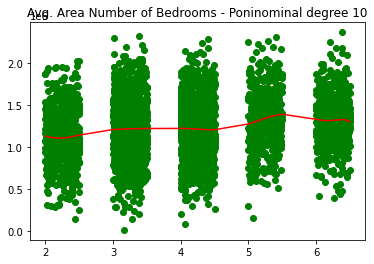

-------------------------------------
Area Population
Train Score: 0.17579324112310624
Train Validation: 0.15159825436636842
MAE: 258268.01891345048


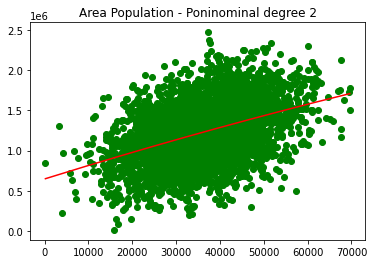

-------------------------------------
Area Population
Train Score: 0.17589686989591868
Train Validation: 0.18944934882835285
MAE: 258259.96880348926


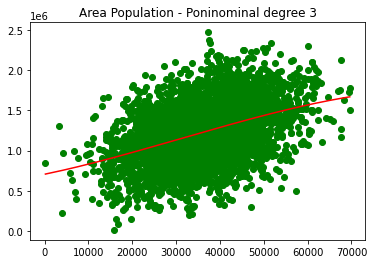

-------------------------------------
Area Population
Train Score: 0.175892635492237
Train Validation: 0.18262990666789602
MAE: 258239.00550250613


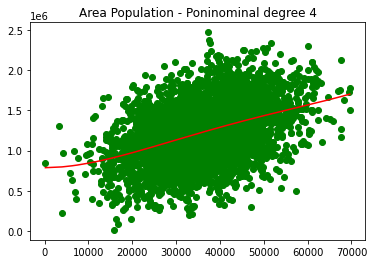

-------------------------------------
Area Population
Train Score: 0.17525862435517825
Train Validation: 0.18127703684019802
MAE: 258287.90413432656


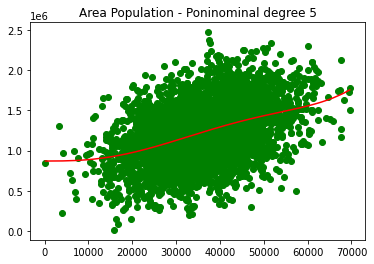

-------------------------------------
Area Population
Train Score: 0.17335731975192503
Train Validation: 0.1035136068893896
MAE: 258537.11240912066


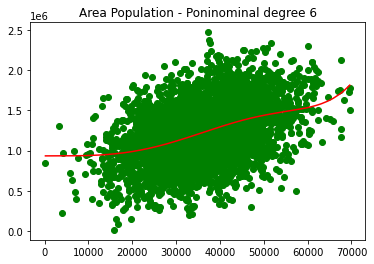

-------------------------------------
Area Population
Train Score: 0.16978937314192444
Train Validation: 0.16463468301971074
MAE: 259075.1432125994


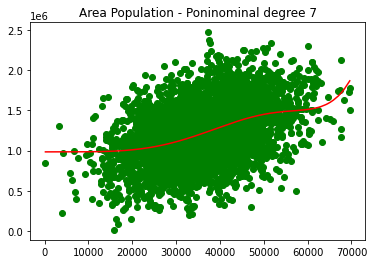

-------------------------------------
Area Population
Train Score: 0.16448491645367336
Train Validation: 0.17986990895623178
MAE: 259866.79166940128


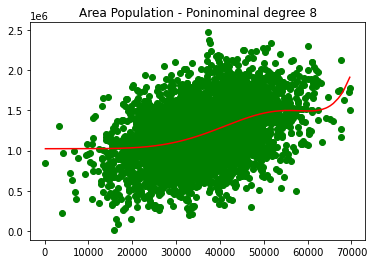

-------------------------------------
Area Population
Train Score: 0.15765929276740287
Train Validation: 0.18126936994545395
MAE: 260830.08323718043


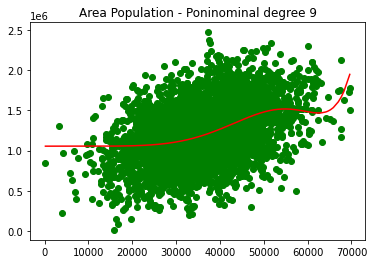

-------------------------------------
Area Population
Train Score: 0.14967631601839282
Train Validation: 0.17187703701035517
MAE: 261961.7817080643


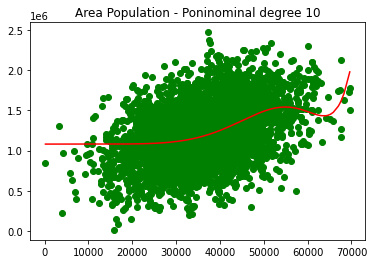

In [59]:
non_linear_func(df)

In [71]:
def overtraining_check(df):
    
    list_columns = df._get_numeric_data().columns.tolist()[:-1]
    
    for column in list_columns:
        
        X = df[[column]]

        # Test/train separación
        X_train, X_test, y_train, y_test = train_test_split(X.values, df["Price"].values, test_size=0.2)

        # Min and max grados a considerar
        degree_min = 2
        degree_max = 10

        scores = []
        train_scores = []
        for degree in range(degree_min,degree_max+1):
            polinominal_model = PolynomialFeatures(degree) 
            X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

            lin_reg_model = LinearRegression()
            lin_reg_model.fit(X_poly, y_train)
            y_pred = lin_reg_model.predict(X_poly)

            train_scores.append(r2_score(y_train, y_pred))

            # cross validation
            kfold = model_selection.KFold(n_splits=10, random_state=42, shuffle=True) 
            cv_results = model_selection.cross_val_score(lin_reg_model, X_train, y_train, cv=kfold)
            
        plt.plot(train_scores, color='red')
        plt.plot(cv_results, color='blue')
        plt.title(column)

        plt.show()

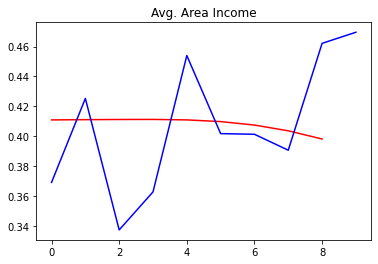

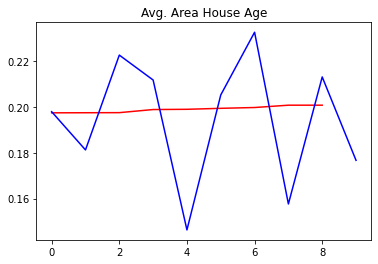

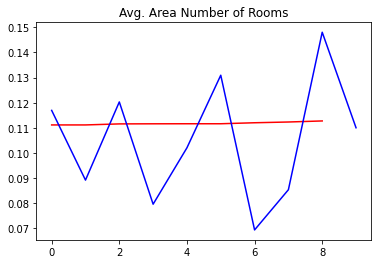

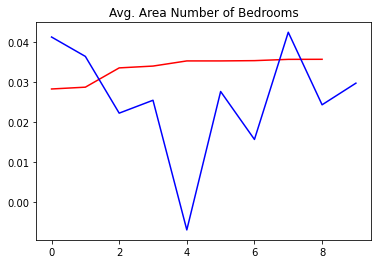

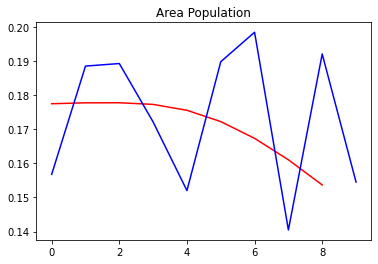

In [72]:
overtraining_check(df)

In [ ]:
# como el conjunto de validacion ha bajado (mientras train sube) por lo que hay sobre-entrenamiento